<a href="https://colab.research.google.com/github/ramyantar/Deep-Learning-Pytorch/blob/main/TP_01_Low_level_MLP_in_PyTorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Multilayer Perceptron in PyTorch

## Introduction

### Goal
Learn the basics of PyTorch (PT) by working on an artificial classification problem.

### Plan
In this tutorial we will create a set of synthetic data that we will use as an example problem.
Then we will create a MLP model and learn its parameters from the data. Finally we will visualize the different learning measures and the parameters of the model.

In a second part we will modify our data and adapt the hyper-parameters (e.g. number of hidden neurons) of our model to allow better classification.

In the next part we will use the basic functions of PT to understand our process and how PT works. But we will also mention the high level features and aids of PT that facilitate our tasks.


### Usage
 
 * Respond to exercices in the next cells.
 * Write your code in between the lines:
 
```
### BEGIN SOLUTION


### END SOLUTION
```

 * You will provide this same notebook completed for assessment.

### Requirements

Python >=3.5

Modules python:
- pytorch >=1.0
- numpy
- matplotlib

### Evaluation considerations
- We take into account the correctness of the solutions but also their generality and quality of the code
- Comment and discuss on the results of all your exercises (in a cell immediately after the results). You may also state the difficulties encountered, lessons learned and your understanding of the problem and solution
- Clean-up your code before submission, do not leave unnecessary code attempts, or if you deem it important, leave them in a way that it is easily understood and with comments/discussion
- We also value the originality of the solutions, don't hesitate in performing unrequested additional tasks in relation to the exercises
- Non-advanced exercises will account for approx. 14/20 of the grade. Advanced exercises will contribute to the remaining score and may compensate for errors in the non-advanced ones
- You may receive help from colleagues on the non-advanced questions, but you must state who has helped you. Approximately 1/20 of the grade is assigned to those that help most.

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

## 0. With a little help from my friends

Write in the following cell the colleagues (if any) that have helped you with this lab assignment (comma separated if more than one and don't state more than 2).

In [ ]:
#Abd Elhaleem Saad

## 1. Data generation

In this part, we will generate a data set of 1000 points which is not linearly separable.

#### Create the artificial data sets



### Exercise 1

Create 1000 points of 2 dimensions $(x_0, x_1)$ with their coordinates between 0 et 1 $x_0, x_1 \in [0, 1]$.



In [ ]:
### BEGIN SOLUTION
# Create a tensor filled with random numbers from a uniform distribution on the interval [0, 1]
x0 = torch.rand(1000, 1)

# Create another tensor filled with random numbers from a uniform distribution on the interval [0, 1]
x1 = torch.rand(1000, 1)

# Stack the two tensors together to create a 2-column matrix
x = torch.column_stack((x0, x1))

# Print the first 5 rows of x0
print(x0[0:5, :])

# Print the first 5 rows of x1
print(x1[0:5, :])

# Print the first 5 rows of x
print(x[0:5, :])

### END SOLUTION


tensor([[0.1292],
        [0.6655],
        [0.6783],
        [0.2231],
        [0.9108]])
tensor([[0.1279],
        [0.2915],
        [0.7847],
        [0.7713],
        [0.5922]])
tensor([[0.1292, 0.1279],
        [0.6655, 0.2915],
        [0.6783, 0.7847],
        [0.2231, 0.7713],
        [0.9108, 0.5922]])



### Exercise 2

Assign to each point a binary class $y$ (0 ou 1) following the condition: 
$$
y = \begin{cases}
1 &\text{if $x_0 > 0.2$ et $x_1 > 0.4$}\\
0 &\text{else}
\end{cases}
$$


In [ ]:
### BEGIN SOLUTION
# Create a tensor of the same size as x0 and x1, where each element is 1 if the corresponding element
# in x0 is greater than 0.2 and the corresponding element in x1 is greater than 0.4, and 0 otherwise
y = torch.where((x0 > 0.2) & (x1 > 0.4), 1, 0)

#another method
out = ((x0 > 0.2) & (x1 > 0.4)).int()

# Print the first 10 rows of x, y, and out
for i in range(10):
    print(f'x = {x[i,:]}, y = {y[i]}')

### END SOLUTION

x = tensor([0.1292, 0.1279]), y = tensor([0])
x = tensor([0.6655, 0.2915]), y = tensor([0])
x = tensor([0.6783, 0.7847]), y = tensor([1])
x = tensor([0.2231, 0.7713]), y = tensor([1])
x = tensor([0.9108, 0.5922]), y = tensor([1])
x = tensor([0.7210, 0.4626]), y = tensor([1])
x = tensor([0.3210, 0.2897]), y = tensor([0])
x = tensor([0.6916, 0.1761]), y = tensor([0])
x = tensor([0.0386, 0.5218]), y = tensor([0])
x = tensor([0.1042, 0.3424]), y = tensor([0])



### Exercise 3

Create a matrix of data `data` with shape `(1000, 3)` with a point per row, the two first columns contain the points coordinates $(x_0, x_1)$ the last column contains the class $y$.


In [ ]:
### BEGIN SOLUTION
# Create a 3-column matrix by stacking x0, x1, and y together
data = torch.column_stack((x0, x1, y))

# Print the shape of the data tensor
print(data.shape)

### END SOLUTION

torch.Size([1000, 3])



### Exercise 4

Split the data into 3 sets (on matrix for each): 800 points for `train`, 100 points for `valid` and 100 for `test`


In [ ]:
### BEGIN SOLUTION

# Split the data tensor into training, validation, and test sets

# The training set contains the first 800 rows of data
train = data[0:800, :]

# The validation set contains the next 100 rows of data
valid = data[800:900, :]

# The test set contains the remaining 100 rows of data
test = data[900:1000, :]

### END SOLUTION

### Exercise 5

Visualise the data using a scatter plot (`plt.scatter`).


We expect to find something similar to this:

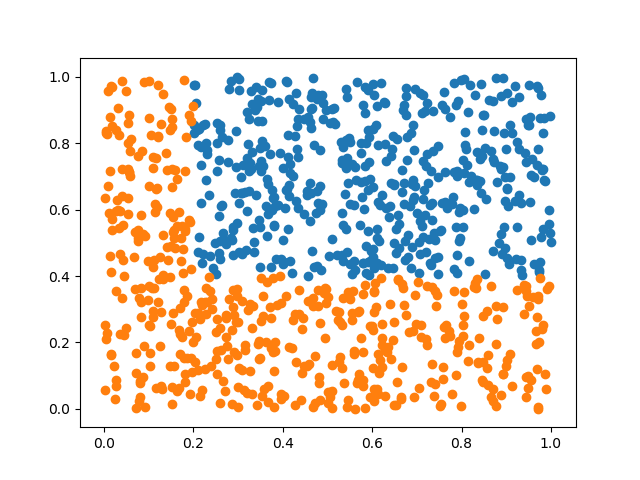

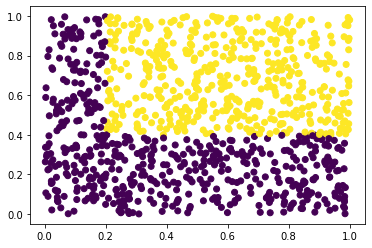

In [ ]:
# Generate, split and plot the data
### BEGIN SOLUTION
import matplotlib.pyplot as plt

# Create a scatter plot of x0 and x1, with the points colored according to the values in y
plt.scatter(data[:, 0], data[:, 1], c=data[:, 2])

# Show the plot
plt.show()

#END SOLUTION

**Run the following cell to make sure you have done the previous exercises correctly.**

In [ ]:
# Verification des dimensions des donnees
assert data.shape == (1000, 3)

# Verification des division desd donnees
assert train.shape == (800, 3)
assert valid.shape == (100, 3)
assert test.shape == (100, 3)

for dataset in [train, valid, test]:
    # Verification des classes
    assert (dataset[dataset[:,-1]==1,0] > 0.2).all()
    assert (dataset[dataset[:,-1]==1,1] > 0.4).all()
    assert ((dataset[dataset[:,-1]==0,0] <= 0.2) | (dataset[dataset[:,-1]==0,1] <= 0.4)).all()
    
print('Everything looks good!')

Everything looks good!


## 2. Creating the model
In this part, we will create, with PyTorch, a model to predict the class $y$ of a point using only its coordinates $(x_0, x_1)$.

The model we will create to classify the data is a Multilayer Perceptron with a single hidden layer:

\begin{align}
h_1 &= \sigma(x W_1 + b_1) \\
\hat{y} &= \sigma(h_1 W_2 + b_2) \\
& \textrm{ avec } & \\
\sigma(t) &= \frac{1}{1+e^{-t}}
\end{align}

$\hat{y}$ will the model's estimation for the class of the point.



### Exercise 6
What are the model parameters?


In [ ]:
#parameters is [W1,W2,b1,b2]

*Implementation en PyTorch*

First we will do a low level implementation where we will only use the AutoDiff feature (which allows to automatically compute gradients) of PyTorch.

PyTorch as une API similaire a celle de numpy. La grande difference etant que pour les symbols pour lesquels on voudra avoir un gradient, nous devons inclure l'argument nommé `requires_grad=True`.

For example $W_1$ is a parameter of the model and we are interested in the gradient of the loss with respect to this symbol. So at initialization time we will add `requires_grad=True`.



### Exercise 7

What the dimensions of each of these symbols: $x, y, W_1, b_1, W_2, b_2$?


In [ ]:
#x=[1000*2]
#y=[1000*1]
#w1=[2*2]
#b1=[2*1]
#w2=[2*1]
#b2=[1*1]



### Exercise 8
Create a function that initializes and returns a tuple with the MLP  parameters.


In [ ]:
# Create the model
### BEGIN SOLUTION

def init_mlp(dim_1, dim_2, dim_3):
    # Initialize the first weight matrix with random values and set requires_grad to True
    w1 = torch.rand(dim_1, dim_2, requires_grad=True)

    # Initialize the second weight matrix with random values and set requires_grad to True
    w2 = torch.rand(dim_2, dim_3, requires_grad=True)

    # Initialize the first bias vector with random values and set requires_grad to True
    b1 = torch.rand(1, dim_2, requires_grad=True)

    # Initialize the second bias vector with random values and set requires_grad to True
    b2 = torch.rand(1, 1, requires_grad=True)

    # Return the initialized weights and biases as a tuple
    return (w1, w2, b1, b2)

### END SOLUTION

# Initialize an MLP with 2 input units, 2 hidden units, and 1 output unit
params = init_mlp(2,2, 1)

# Print the shape of the bias vector for the output layer
print (params[3].shape)

# Print the initialized parameters
print (params)


torch.Size([1, 1])
(tensor([[0.9172, 0.6099],
        [0.0515, 0.0748]], requires_grad=True), tensor([[0.0311],
        [0.2275]], requires_grad=True), tensor([[0.6344, 0.1783]], requires_grad=True), tensor([[0.8233]], requires_grad=True))


*Run a forward pass of the model on the following data points*

### Exercise 8
What is the desired response for the following points?
$$(0.1, 0.5), (0.3, 0.5), (0.3, 0.15), (0.1, 0.15)$$



In [ ]:
(0,1,0,0)

(0, 1, 0, 0)

### Exercise 9
Execute the model on the previous points and print $\hat{y}$


In [ ]:
### BEGIN SOLUTION  
# Create a function sigmoid(t) that computes the sigmoid function on t
def sigmoid(t):
    s = 1 / (1 + torch.exp(-t))
    return s

# Create a function mlp(x, params) that computes the MLP outputs given the inputs x
def mlp (x,params):
  # Extract the weight matrices and bias vectors from the params tuple
  w1=params[0]
  w2=params[1]
  b1=params[2]
  b2=params[3]

  # Apply the first layer of the MLP to the input tensor x
  z1=sigmoid(torch.matmul(x, w1)+b1)

  # Apply the second layer of the MLP to the tensor z1
  z2=sigmoid(torch.matmul(z1,w2)+b2)

  # Return the output tensor z2
  return z2

# Create a tensor containing the previous points
tensor=torch.tensor([[0.1,0.5], [0.3,0.5],[0.3,0.15],[0.1,0.15]])
print(tensor.shape)

# Call and print output of mlp(points, params) (NOTE: use torch.no_grad())
with torch.no_grad():
  output = mlp(tensor, params)
print(output)
### END SOLUTION

torch.Size([4, 2])
tensor([[0.7259],
        [0.7275],
        [0.7272],
        [0.7256]])


We can observe that the results are not good, because they are far from the expected result.

If we want to compute on our test data the performance of the model we will define an accuracy function, which takes a decision for each data based on $\hat{y}$ and compares it to $y$.

$$
\text{accuracy} = \frac{1}{N} \sum_i^N (1 - abs(y - round(\hat{y}_i))) 
$$

The accuracy represents the rate of correctly classified points. It will be $1$ if all points are correctly classified, $0$ if all are misclassified and $0.5$ if half are well classified.



### Exercise 10

Implement the accuracy using Pytorch functions `torch.mean`, `torch.abs`, `torch.round`.


In [ ]:
# Define the function 'accuracy' which takes in two arguments: 'estimated' and 'reference'
def accuracy(estimated, reference):
    # Calculate the accuracy of the estimated values compared to the reference values
    accuracy = torch.mean(1-torch.abs(reference- torch.round(estimated)))

    # Return the calculated accuracy
    return accuracy

# Define the variable 'reference' which holds the values from the third column of 'data'
reference = data[:,2]

# Define the variable 'tensor' which holds the values from the first and second columns of 'data'
tensor = data[:,0:2]

# Define the variable 'estimated' which holds the result of passing 'tensor' and 'params' to the 'mlp' function
estimated = mlp(tensor,params)

# Define the variable 'ac' which holds the result of passing 'estimated' and 'reference' to the 'accuracy' function
ac = accuracy(estimated,reference)

# Print the value of 'ac'
print(ac)


tensor(0.4750, grad_fn=<MeanBackward0>)


### Exercise 11

Write a `score_model` function that evaluates the performance (accuracy) of the model on a given data set. Print the result 


In [ ]:
# Define the function 'score_model' which takes in two arguments: 'params' and 'data'
def score_model(params, data):
    # Define the variable 'reference' which holds the values from the third column of 'data'
    reference=data[:,[2]]

    # Define the variable 'tensor' which holds the values from the first and second columns of 'data'
    tensor=data[:,0:2]

    # Define the variable 'estimated' which holds the result of passing 'tensor' and 'params' to the 'mlp' function
    estimated=mlp(tensor,params)

    # Define the variable 'ac' which holds the result of passing 'estimated' and 'reference' to the 'accuracy' function
    ac=accuracy(estimated,reference)

    # Return the value of 'ac'
    return ac

# Define the variable 'acc' which holds the result of passing 'params' and 'train' to the 'score_model' function
acc = score_model(params, train).item()

# Print the score of the model on the train data
print(f'score train: {acc:.2%}')


score train: 47.75%


### Exercise 12
Do the same with `valid` and `test`


In [ ]:
print(f'score valid: {score_model(params, valid):.2%}')
print(f'score test: {score_model(params, valid):.2%}')


score valid: 48.00%
score test: 48.00%


### Exercise 13

Explain the results.

In [ ]:
# the accuracy of the system estimation is not good

## 4. Training the model

To find the best parameters for our model we will enter it with the training data. For this we will define a cost function to optimize.

As we are trying to solve a binary classification task, we will use the crossentropy cost function:

$$
L = \sum -y \log(\hat{y}) - (1-y) \log(1-\hat{y})
$$



### Exercise 14
Implement the cost function in PyTorch.


In [ ]:
def bce(est, ref):
    ### BEGIN SOLUTION
    #apply  the  binary  cross  entropy  function  returning  the  loss
    loss = torch.sum((-ref * torch.log(est)) - (1-ref) * torch.log(1-est))
    return loss
    ### END SOLUTION

To train our model by means of Gradient Descent (GD) we will iteratively update with small increments our parameters:

\begin{align}
W_1^n &= W_1^{n-1} - \eta \frac{\delta L}{\delta W_1} \\
b_1^n &= b_1^{n-1} - \eta \frac{\delta L}{\delta b_1} \\
W_2^n &= W_2^{n-1} - \eta \frac{\delta L}{\delta W_2} \\
b_2^n &= b_2^{n-1} - \eta \frac{\delta L}{\delta b_2}
\end{align}

Where $\eta$ is our learning rate.

We need to calculate the gradients:
$$
\frac{\delta L}{\delta W_1}, \frac{\delta L}{\delta b_1}, \frac{\delta L}{\delta W_2}, \frac{\delta L}{\delta b_2}
$$

For the gradients of the cost function with respect to the parameters, we could calculate them by hand. But we are lazy. So we will use PyTorch `error.backward()` will do this for us in an optimized way using Dynamic Programming (DP) and populate the tensors with the gradients.

Finally we will run a training of 10 `epochs` with a `batch_size=100`.
For this we will do the following steps:
1. Calculate the number of iterations (`n_iterations`) per epoch (remember that an iteration is an update of the parameters and an epoch is a competing use of all our training data)
2. Create a session
3. Initialize the variables
4. For each epoch (`for epoch in range(n_epochs):`)
    1. Randomly reorder the `train` data (use `torch.randperm()`)
    2. Evaluate and print the model score on the training data
    3. For each iteration (`for iteration in range(n_iterations):`)
        1. Select a block of `batch_size` examples
        2. *Zero the gradients*
        3. Run the forward pass on the model (`mlp()`)
        4. Compute the loss (`bce()`)
        5. Compute the gradients
        6. *Update the parameters doing gradient descent*

**Note:** Remember that PyTorch keeps track of all the operations you make with tensors to build the DAG graph. In some cases we want to avoid that, such as when setting the gradients to zero or performing the gradient descent update of the parameters. In those cases we may encapsulate the operations inside a `with torch.no_grad():` context clause. Furthermore the `grad` attribute of the tensors, may be `None` (no need to set to zero in this case) during the first run so one may do:

```
with torch.no_grad():
    if param.grad is not None:
        param.grad.zero_()

```

**Note:** When performing the parameter update of gradient descent, make sure not to reassign to the parameter a new tensor object. To avoid doing so use an inplace operation:

```
with torch.no_grad():
    param -= eta * param.grad
```

If you erronously do this `param = param - eta * param.grad`, `param` will point to a new tensor, not the original parameters of the model.

**Note:** Zero the gradients means accessing the gradient of each parameter and setting it to zero. We need this because PyTorch `.backward()` method accumulates the gradients instead of replacing them.
    


### Exercise 15

Implement and run a train loop for the model.

In [ ]:
def train_model(params, data, eta=0.05, n_epochs=1, batch_size=16):
    """
    This function trains a model with given parameters and data.

    params: the parameters of the model
    data: the data to be used for training
    eta: the learning rate (with value is 0.05)
    n_epochs: the number of epochs (with value is 1)
    batch_size: the size of the batch (with value is 16)
    """

    n_data = data.shape[0]
    n_iterations = n_data // batch_size #divide the first argument by the second and round the result down to the nearest whole number.
    
    # Convert the parameters to a list so that we can iterate over them
    param_list=list(params) 

    for epoch in range (n_epochs):
        # Randomly reorder the data (use `torch.randperm()`)
        perm = torch.randperm(len(data))
        data = data[perm]
        # Print the epoch number every 10 epochs
        if(((epoch) % 10) == 0):            
            print("Epoch:",epoch )
            # Calculate the accuracy of the model on the data
            acc = score_model(param_list, data).item()
            # Print the accuracy of the model
            print(f'score train: {acc:.2%}')

        for it in range (n_iterations):  
            x=data[batch_size*it : batch_size*(it+1),:2]   
            y=data[batch_size*it : batch_size*(it+1),-1]   
            # Zero the gradient 
            with torch.no_grad():
                # Loop through each parameter in the model
                for param in param_list:
                    # If the parameter has a gradient, set it to zero
                    if param.grad is not None:
                        param.grad.zero_()            
            # use predict function to get the prediction value of y, then transpose the shape
            yhat=mlp(x,param_list).t() 
            # Compute the error and backpropagate
            error=bce(yhat,y)            
            error.backward()
            # Update the parameters using the gradients
            with torch.no_grad():
                # Loop through each parameter in the model
                for idx in range (len(param_list)):
                    # Update the parameter by subtracting the product of the learning rate and the gradient from the parameter
                    param_list[idx]-= eta*param_list[idx].grad

params = init_mlp(2, 2, 1)                    
train_model(params, train, eta=0.05, n_epochs=100)

Epoch: 0
score train: 47.75%
Epoch: 10
score train: 84.50%
Epoch: 20
score train: 86.12%
Epoch: 30
score train: 89.25%
Epoch: 40
score train: 95.50%
Epoch: 50
score train: 96.63%
Epoch: 60
score train: 97.12%
Epoch: 70
score train: 97.62%
Epoch: 80
score train: 98.50%
Epoch: 90
score train: 97.25%


## 5. Visualizing the model

To monitor the evolution of the learning of our model, we will visualize the value of the cost function, the classification score and the parameters of the first layer of our model.  

We will run our experiments with different values of the following hyperparameters to better understand their effect:
- `learning_rate`
- `batch_size`


**Visualization of the cost function**

The cost function is the value we aim to reduce with the training iterations. To visualize it we will create an empty list (`couts = []`) at the beginning of our training and we will add (`couts.append(cout)`) the value resulting from the cost at each iteration. At the end of the training we will visualize the curve (`plt.plot(costs)`).

### Exercise 16
Rewrite the `train_model` function so that it returns the average loss of every epoch. Run it and plot the loss of a training procedure. While we are at it, make the printing optional with an additional keyword argument.

In [ ]:
def train_model(params, data, eta=0.05, n_epochs=1, batch_size=16, print_results=False):
    n_data = data.shape[0]
    n_iterations = n_data // batch_size

    # Initialize a list to store the loss values for each epoch   
    losses = []
    param_list=list(params)
    for epoch in range(n_epochs):
        # Randomly reorder the data (use `torch.randperm()`)
        perm = torch.randperm(len(data))
        data = data[perm]
        # Print the results for every 10 epochs, and if the argument print_results=True
        if print_results and ((epoch + 1) % 10 == 0):            
            print("Epoch:", epoch + 1)
            acc = score_model(param_list, data).item()
            print(f'score train: {acc:.2%}')
        # Initialize the loss for this epoch           
        epoch_loss = 0
        for it in range(n_iterations):  
            x = data[batch_size*it:batch_size*(it + 1),:2]   
            y = data[batch_size*it:batch_size*(it + 1),-1]   

            with torch.no_grad():
                for param in param_list:
                    if param.grad is not None:
                        param.grad.zero_()
             # Compute the model output and error  
            yhat = mlp(x, param_list).t()          
            error = bce(yhat, y)
            # Accumulate the epoch loss
            epoch_loss += error.item()            
            # Compute gradients
            error.backward()
            with torch.no_grad():
                for idx in range(len(param_list)):
                    param_list[idx] -= eta * param_list[idx].grad

        # Append the average loss  to the list of losses
        losses.append(epoch_loss / n_iterations)
        
    return losses

params = init_mlp(2, 2, 1)                    
print(train_model(params, train, eta=0.05, n_epochs=100))


[11.020993957519531, 10.62956283569336, 9.68984094619751, 8.191902256011963, 6.958263607025146, 6.222340807914734, 5.780825533866882, 5.580335083007813, 5.490365200042724, 5.448195850849151, 5.537205100059509, 5.400217747688293, 5.408414511680603, 5.460418622493744, 5.398535189628601, 5.226158633232116, 5.3567045879364015, 5.243105945587158, 5.276615171432495, 5.276168580055237, 5.142269065380097, 5.1195458936691285, 5.1010147190094, 4.9725416874885555, 4.876558728218079, 4.834975531101227, 4.651816260814667, 4.464826910495758, 4.300351724624634, 4.106053458452225, 3.8934557104110716, 3.6135438442230225, 3.36705292224884, 3.2705054926872252, 3.050373542308807, 2.937238779067993, 2.84637243270874, 2.7001925706863403, 2.58137485742569, 2.470735046863556, 2.397062567472458, 2.359642927646637, 2.268113704919815, 2.2146228408813475, 2.0944602918624877, 2.042479292154312, 1.9839117097854615, 1.9398133158683777, 1.8878263795375825, 1.897336677312851, 1.836434475183487, 1.7532411575317384, 1.7

Epoch: 10
score train: 85.00%
Epoch: 20
score train: 86.87%
Epoch: 30
score train: 95.63%
Epoch: 40
score train: 96.38%
Epoch: 50
score train: 97.87%
Epoch: 60
score train: 97.50%
Epoch: 70
score train: 98.00%
Epoch: 80
score train: 98.00%
Epoch: 90
score train: 98.62%
Epoch: 100
score train: 98.50%


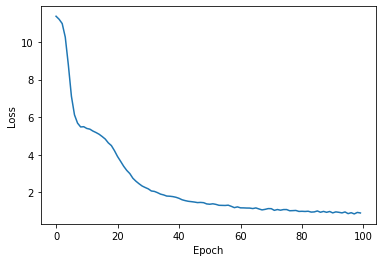

In [ ]:
params = init_mlp(2,2,1)
losses = train_model(params, train, eta=0.05, n_epochs=100, batch_size=16, print_results= True )
# Plot the losses
plt.plot(losses)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

**Effect of the learning rate**

We will run our learning with different learning rates to see its effect on the cost function.



### Exercise 17
Display the training loss curve for learning rates `[0.5, 0.05, 0.005, 0.0005]`

[14.32396668434143, 10.634545421600341, 6.247679538726807, 5.6214286637306214, 2.9659100651741026, 4.275491898059845, 1.952929469347, 2.9202267187833786, 2.2684197542071343, 2.9315197111666205, 2.8547497627139093, 1.9835640281438827, 1.9717332556843759, 1.8595546567440033, 1.742656094878912, 1.576334958076477, 1.9096028286218643, 2.5617105078697207, 1.9132416293025016, 1.7975124560296536, 1.308178828060627, 1.820726116299629, 1.5425410097837449, 1.4252494107186795, 1.4969467443227769, 2.179487192928791, 0.9580852198600769, 1.0645043894648551, 1.7291704084724189, 2.8075596968829633, 1.1384773716330527, 1.4404261347651481, 1.5216417083144187, 1.280898241698742, 1.071011322438717, 1.6451691243052482, 1.211836251616478, 1.1506686709821223, 1.5455756522715092, 1.3189546452462673, 1.233484658524394, 1.0742880913615227, 1.1607736867666245, 1.166674942523241, 1.3327389303594828, 1.1738336073607207, 0.7121512660384178, 1.7009878918528556, 2.057238654345274, 1.1916919077932835, 1.025038368031382

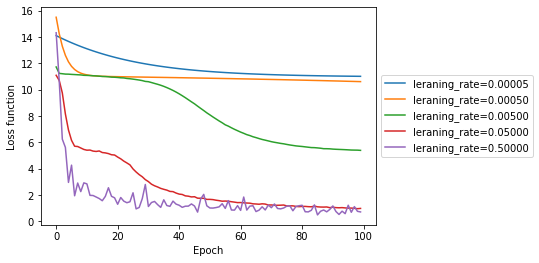

In [ ]:
learning_rates = [0.5, 0.05, 0.005, 0.0005, 0.00005]
n_epochs = 100
batch_size = 16

losses = {}

# Train a model with each learning rate and populate losses with the learning rate as key and the loss series as values
### BEGIN SOLUTION
# Iterate over a list of learning rates
for lr in learning_rates:
    # Initialize the model parameters
    params = init_mlp(2,2,1)
    
    # Train the model with the current learning rate  = [0.5, 0.05, 0.005, 0.0005, 0.00005]
    loss = train_model(params, train, eta=lr, n_epochs=100, batch_size=16, print_results= False )
    
    # Save the training loss for the current learning rate
    losses[lr] = loss

# Print the training loss for the learning rate of 0.5
print(losses[0.5])

# Print the training loss for the learning rate of 0.05
print(losses[0.05])
### END SOLUTION

plt.figure()
for lr, loss_curve in sorted(losses.items()):
    plt.plot(loss_curve, label=f'leraning_rate={lr:.5f}')

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.ylabel('Loss function')
plt.xlabel('Epoch');

**Effect of batch size**

We will now run our training with different batch sizes to see its effect on the cost function.

### Exercise 18

Display the cost function evaluated on all training data at each epoch for batch sizes `[n_data, 100, 50, 10, 5, 1]`


 batch_size = 800, learning rate = 0.005
 batch_size = 100, learning rate = 0.05
 batch_size = 10, learning rate = 0.05
 batch_size = 1, learning rate = 0.05


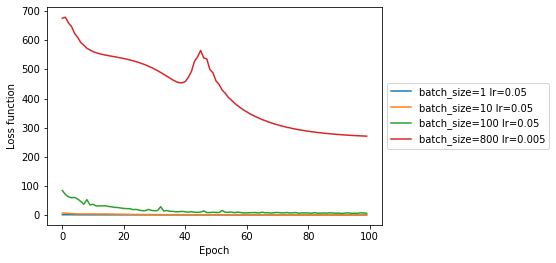

In [ ]:
n_data = train.shape[0]

n_epochs = 100
batch_sizes = [n_data, 100, 10, 1]
lrs = [0.005, 0.05, 0.05, 0.05]

# Initialize a dictionary to store the training losses
losses = {}

### BEGIN SOLUTION
for b_s,lr in zip(batch_sizes,lrs):
    # Initialize the model parameters
    params = init_mlp(2, 2, 1)
    # Print the current batch size and learning rate
    print(f' batch_size = {b_s}, learning rate = {lr}')
    # Train the model using the current batch size and learning rate   
    loss= train_model(params, train, eta=lr, n_epochs=100, batch_size=b_s, print_results = False )
    # Store the loss value in the losses dictionary
    losses[(b_s,lr)] = loss
### END SOLUTION

# Visualiser les courbes de cout
plt.figure()
for (bs, lr), loss_curve in sorted(losses.items()):
    plt.plot(loss_curve, label=f'batch_size={bs} lr={lr}')

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.ylabel('Loss function')
plt.xlabel('Epoch');

**Visualization of the performance**

Another value worth monitoring is the classification accuracy of the model.



### Exercise 19

Visualize the accuracy on the train, valid and test data on each epoch

Text(0.5, 0, 'Epoch')

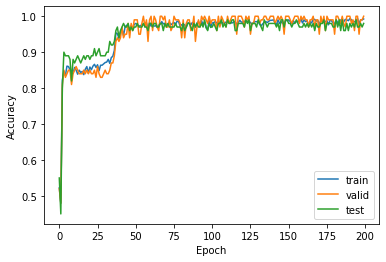

In [ ]:
n_data = train.shape[0]

n_epochs = 200
batch_size = 16
learning_rate_value = 0.05
# Create a dictionary to store the accuracy of the model on the training, validation, and test data
accuracies = {}
accuracies['train'] = []
accuracies['valid'] = []
accuracies['test'] = []

def train_model_modified(params, train, valid, test, eta=0.05, n_epochs=1, batch_size=16, print_results = False):
    n_data = train.shape[0]
    n_iterations = n_data // batch_size
    # Convert the parameters to a list 
    param_list = list(params)
    # Loop over epochs
    for epoch in range(n_epochs):
        # Randomly reorder the `train` data 
        perm = torch.randperm(len(train))
        train = train[perm]

        # Loop over iterations within an epoch
        for it in range(n_iterations):

            # Get one batch of data
            batch = train[batch_size* it: batch_size*(it+1)]
            x = batch[:,:2]
            y = batch[:,2]

            # Forward pass: compute predicted y using the model
            yhat=mlp(x,param_list).t() 
            # Compute and print loss
            error = bce(yhat, y)

            # Zero the gradients before running the backward pass.
            with torch.no_grad():
                for param in param_list:
                    if param.grad is not None:
                        param.grad.zero_()

            # Backward pass: compute gradient of the loss 
            error.backward()

            # Update the parameters using their gradients
            with torch.no_grad():
                for idx in range (len(param_list)):
                    param_list[idx]-= eta*param_list[idx].grad
            
        # # Calculate accuracy  on the training , validation and test data 
        ac_train = score_model(param_list, train).item()
        ac_vaild = score_model(param_list, valid).item()
        ac_test = score_model(param_list, test).item()
        # Store the calculated accuracies in the `accuracies` dictionary
        accuracies['train'].append(ac_train)
        accuracies['valid'].append(ac_vaild)
        accuracies['test'].append(ac_test)
    return accuracies

    
params = init_mlp(2,2,1)
accuracies = train_model_modified(params, train, valid, test, eta=learning_rate_value, n_epochs=n_epochs, batch_size=batch_size, print_results = False) 


plt.figure()
for split, v in accuracies.items():
    plt.plot(v, label=split)

plt.legend(loc='best')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')

**Visualization of the model parameters**

For pedagogical reasons we will now visualize the parameters of the model with its geometrical interpretation.
We will represent the parameters of the first layer of the MLP as a line (the decision boundary).

In [ ]:
def plot_decision_boundaries(w, b, ax=None, **kwargs):
    ax = ax or plt.gca()
    x0, x1 = ax.get_xlim()
    y0, y1 = ax.get_ylim()
    arts = []
    for i in range(w.shape[1]):
        w_i = w[:, i]
        if len(b.shape)==1:
            b_i = b[i]
        else:
            b_i = b[:, i]
        
        intersections = []
        
        if w_i[1] != 0:
            yx0 = -w_i[0]/w_i[1] * x0 - b_i/w_i[1]
            yx1 = -w_i[0]/w_i[1] * x1 - b_i/w_i[1]
            
            if y0 <= yx0 <= y1:
                intersections.append((x0, yx0))
            
            if y0 <= yx1 <= y1:
                intersections.append((x1, yx1))
            
        if w_i[0] != 0:
            xy0 = -w_i[1]/w_i[0] * y0 - b_i/w_i[0]
            xy1 = -w_i[1]/w_i[0] * y1 - b_i/w_i[0]
            
            if x0 <= xy0 <= x1:
                intersections.append((xy0, y0))
            
            if x0 <= xy1 <= x1:
                intersections.append((xy1, y1))

        if len(intersections) == 2:
            xs, ys = zip(*intersections)
            lines, = ax.plot(xs, ys, **kwargs)
        
            arts.append(lines)
    
    ax.set_xlim([x0, x1])
    ax.set_ylim([y0, y1])
    
    return arts
        
def plot_model_and_data(params, dat=None, sel=None, ax=None):
    w, b, _, _ = params
    ax = ax or plt.gca()
    ax.set_prop_cycle(None)
    prop_cycle = ax._get_patches_for_fill.prop_cycler

    import itertools
    props = list(itertools.islice(prop_cycle, 3))
    
    all_arts = []
    
    if dat is not None:
        arts = ax.scatter(dat[dat[:,-1]==1,0], dat[dat[:,-1]==1,1], 
                            facecolors='none', edgecolors=props[0]['color'], alpha=0.2)
        all_arts.append(arts)

        arts = ax.scatter(dat[dat[:,-1]==0,0], dat[dat[:,-1]==0,1], 
                            facecolors='none', edgecolors=props[1]['color'], alpha=0.2)
        all_arts.append(arts)
    
    if sel is not None:
        arts = ax.scatter(sel[sel[:,-1]==1,0], sel[sel[:,-1]==1,1], 
                            facecolors=props[0]['color'], edgecolors=props[0]['color'])
        all_arts.append(arts)

        arts = ax.scatter(sel[sel[:,-1]==0,0], sel[sel[:,-1]==0,1], 
                            facecolors=props[1]['color'], edgecolors=props[1]['color'])
        all_arts.append(arts)
    
    line_arts = plot_decision_boundaries(w.detach().numpy(), b.detach().numpy(),
                             ax=ax,
                             color=props[2]['color'],
                             linewidth=2.0)
    all_arts += line_arts
    
    return all_arts

You can use the two functions created above to visualize a learning animation. You simply get the value returned by the function `plot_model_and_data(params, sel=train, ax=ax)` after each epoch. 

```
art = plot_model_and_data(params, sel=train, ax=ax)
arts.append(art)
``` 



### Exercise 20
Visualise the decision boundaries during a training procedure.

In [ ]:
def model_visualize(params, data, eta=0.05, n_epochs=1, batch_size=16):
    n_data = data.shape[0]
    n_iterations = n_data // batch_size
    arts = []
    param_list = list(params)

    for epoch in range(n_epochs):
        # Randomly reorder the `train` data
        perm = torch.randperm(len(data))
        data = data[perm] 

        for it in range(n_iterations):
            x=data[batch_size*it : batch_size*(it+1),:2]   
            y=data[batch_size*it : batch_size*(it+1),-1]


            with torch.no_grad():
                # Loop through each parameter in the model
                for param in param_list:
                    # If the parameter has a gradient, set it to zero
                    if param.grad is not None:
                        param.grad.zero_()   

            yhat = mlp(x , param_list).t()
            # Compute the error and backpropagate
            error = bce(yhat, y)                             
            error.backward()
            # Update the parameters using the gradients
            with torch.no_grad():
              for  idx in range(len(param_list)):
                  param_list[idx] -= eta * param_list[idx].grad 

        with torch.no_grad():
            w1, w2, b1, b2 = param_list
            # Plot the model and training data
            art = plot_model_and_data((w1,b1, w2, b2), sel=data, ax=ax)
            arts.append(art)

    return arts


torch.Size([2, 1])


/usr/local/lib/python3.8/dist-packages/numpy/core/shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)


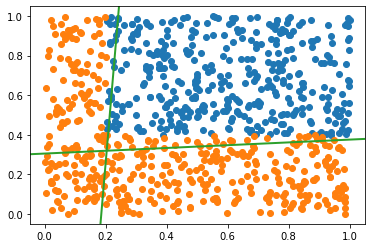

In [ ]:
n_epochs = 250
batch_size = 10
learning_rate_value = 0.005
fig, ax = plt.subplots()
params = init_mlp(2,2,1)
w, b, _, _ = params
print(b.shape)
#call the model_visualize function and animate boundaries
arts = model_visualize(params, train, eta=learning_rate_value, n_epochs=n_epochs, batch_size=batch_size)  

anim = animation.ArtistAnimation(fig, arts, interval=50, repeat_delay=3000, blit=True);
HTML(anim.to_jshtml())

## Further exploration

### [Advanced] Exercise 21

Create a new dataset as the one depicted below.

It is similar to the first one we created, but for which we require more hidden units to classify correctly.

Visualize the model being trained with an incrementing number of hidden units until reaching the theoretical minimum required amount.

torch.Size([1000, 3])
x = tensor([0.1292, 0.1279]), y = tensor([0])
x = tensor([0.6655, 0.2915]), y = tensor([0])
x = tensor([0.6783, 0.7847]), y = tensor([1])
x = tensor([0.2231, 0.7713]), y = tensor([1])
x = tensor([0.9108, 0.5922]), y = tensor([1])
x = tensor([0.7210, 0.4626]), y = tensor([1])
x = tensor([0.3210, 0.2897]), y = tensor([0])
x = tensor([0.6916, 0.1761]), y = tensor([0])
x = tensor([0.0386, 0.5218]), y = tensor([0])
x = tensor([0.1042, 0.3424]), y = tensor([0])


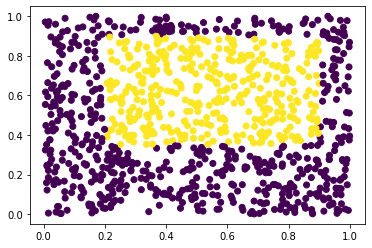

In [ ]:
# Creating Dataset
x0_2 = torch.rand(1000)
x1_2 = torch.rand(1000)
# Assign a binary class to each point
y_2=torch.where((x0_2 > 0.2) & (x0_2 < 0.9) & (x1_2 > 0.35) & (x1_2 < 0.9),1,0 )

data_2 = torch.column_stack((x0_2, x1_2, y_2))
print(data_2.shape)

# Print the first 10 points and their classes
for i in range(10):
    print(f'x = {x[i,:]}, y = {y[i]}')

plt.scatter(data_2[:,0],data_2[:,1],c=data_2[:,2])
plt.show()

In [ ]:
# Split the data into train, validation, and test sets
train_2 = data_2[:800]
val_2 = data_2[800:900]
test_2 = data_2[900:1000]

torch.Size([10, 1])


/usr/local/lib/python3.8/dist-packages/numpy/core/shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)


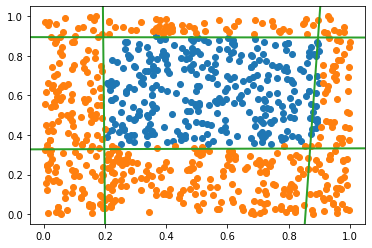

In [ ]:
n_epochs = 250
batch_size = 10
learning_rate_value = 0.5
fig, ax = plt.subplots()
#increase the hidden layer to be 4
paramss = init_mlp(2,4,1)
print(b.shape)
#call the model_visualize function and animate boundaries
arts = model_visualize(paramss, train_2, eta=learning_rate_value, n_epochs=n_epochs, batch_size=batch_size)  

anim = animation.ArtistAnimation(fig, arts, interval=50, repeat_delay=3000, blit=True);
HTML(anim.to_jshtml())

 number of hidden units = 2
 number of hidden units = 3
 number of hidden units = 4
 number of hidden units = 5
 number of hidden units = 6
 number of hidden units = 7
 number of hidden units = 8
 number of hidden units = 9
 number of hidden units = 10


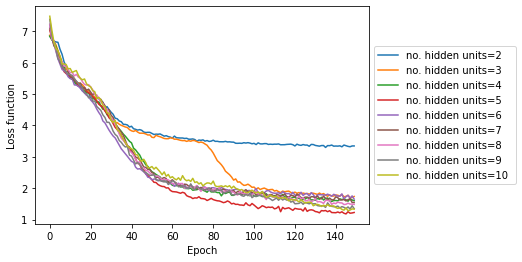

In [ ]:
# Define a list of different numbers of hidden units to try
nh_list = [2,3,4,5,6,7,8,9,10]

# Create an empty dictionary to store the loss values for each number of hidden units
losses = {}

# Set the number of epochs and batch size for training
n_epochs = 150
batch_size = 10

# Set the learning rate
learning_rate= 0.05

# Loop through each number of hidden units
for n_h in nh_list:
    # Initialize the model parameters
    params = init_mlp(2,n_h, 1)
    print(f' number of hidden units = {n_h}')

    # Train the model and get the loss value
    loss = train_model(params, train_2, eta=learning_rate, n_epochs=n_epochs, batch_size=batch_size, print_results = False )

    # Store the loss value in the dictionary
    losses[n_h] = loss

#visulaize the data
plt.figure()
for n_h, loss_curve in sorted(losses.items()):
    plt.plot(loss_curve, label=f'no. hidden units={n_h} ')

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.ylabel('Loss function')
plt.xlabel('Epoch');

### [Advanced] Exercise 22

Implement another (or all) alternative optimizers that we have seen in the lecture. Plot the loss curves of them on a same plot together with vanilla SGD.

In [ ]:
def momentum(params, data, eta=0.05, n_epochs=1, batch_size=16, print_results=False):
    n_data = data.shape[0]
    n_iterations = n_data // batch_size
    gama=0.9
    # Initialize a list to store the loss values for each epoch   
    losses = []
    # Initialize m  
    m=[torch.zeros(params[0].size()),torch.zeros(params[1].size()),torch.zeros(params[2].size()),torch.zeros(params[3].size())]

    param_list=list(params)
    for epoch in range(n_epochs):
        # Randomly reorder the data (use `torch.randperm()`)
        perm = torch.randperm(len(data))
        data = data[perm]
        # Print the results for every 10 epochs, and if the argument print_results=True
        if print_results and ((epoch + 1) % 10 == 0):            
            print("Epoch:", epoch + 1)
            acc = score_model(param_list, data).item()
            print(f'score train: {acc:.2%}')
        # Initialize the loss for this epoch           
        epoch_loss = 0
        for it in range(n_iterations):  
            x = data[batch_size*it:batch_size*(it + 1),:2]   
            y = data[batch_size*it:batch_size*(it + 1),-1]   

            with torch.no_grad():
                for param in param_list:
                    if param.grad is not None:
                        param.grad.zero_()
             # Compute the model output and error  
            yhat = mlp(x, param_list).t()          
            error = bce(yhat, y)
            # Accumulate the epoch loss
            epoch_loss += error.item()            
            # Compute gradients
            error.backward()
            with torch.no_grad():
                for idx in range(len(param_list)):
                    m[idx]= gama * m[idx] + eta * param_list[idx].grad
                    param_list[idx] -= m[idx]

        # Append the average loss  to the list of losses
        losses.append(epoch_loss / n_iterations)
        
    return losses

params = init_mlp(2, 2, 1)                    
print(momentum(params, train_2, eta=0.05, n_epochs=100))


[12.448768463134765, 8.183996081352234, 5.27610955953598, 3.8983357453346255, 3.214085111618042, 2.138723894059658, 1.6540740010142327, 1.5509695386886597, 1.8919561433792114, 2.0427185398340226, 1.8055175551772118, 1.9636949917674065, 3.6925138880312445, 1.847104989141226, 1.365240096822381, 3.1775097607076166, 1.2680592457950115, 2.2235235311090946, 1.578205315247178, 0.7054236169531941, 1.3488862346485258, 0.8932621535658837, 0.9089578986912966, 1.16267453212291, 0.9086352345719934, 1.9632972709834575, 1.0500088308751583, 0.7225725834444165, 0.8649116020649672, 1.955029139369726, 1.1666271682083607, 0.6516310707479716, 0.8485564202442766, 0.8229048635438084, 0.5718516232818365, 1.180088220126927, 0.8199203298985958, 0.7477850308269263, 0.849987225085497, 0.8706575903296471, 0.8049097340553999, 2.098076671399176, 1.1345801040530206, 1.197741909325123, 0.8457640807330609, 1.6011575875431299, 0.7909538603946566, 0.7975673061609269, 0.8237918842211366, 0.6725328245386482, 0.905092660821

Epoch: 10
score train: 97.37%
Epoch: 20
score train: 96.00%
Epoch: 30
score train: 99.37%
Epoch: 40
score train: 98.37%
Epoch: 50
score train: 98.75%
Epoch: 60
score train: 96.75%
Epoch: 70
score train: 98.37%
Epoch: 80
score train: 96.63%
Epoch: 90
score train: 96.88%
Epoch: 100
score train: 95.38%
Epoch: 10
score train: 86.12%
Epoch: 20
score train: 88.13%
Epoch: 30
score train: 96.00%
Epoch: 40
score train: 98.00%
Epoch: 50
score train: 97.37%
Epoch: 60
score train: 97.50%
Epoch: 70
score train: 98.25%
Epoch: 80
score train: 98.25%
Epoch: 90
score train: 98.37%
Epoch: 100
score train: 97.12%


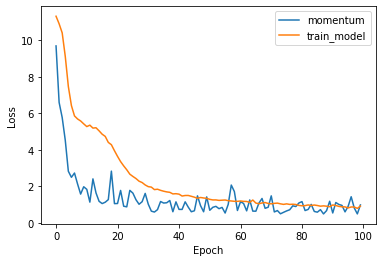

In [ ]:
params_1 = init_mlp(2,2,1)
params_2 = init_mlp(2,2,1)
losses_1 = momentum(params_1, train_2, eta=0.05, n_epochs=100, batch_size=16, print_results= True )
losses_2 = train_model(params_2, train_2, eta=0.05, n_epochs=100, batch_size=16, print_results= True )
# Plot the losses
plt.figure()
plt.plot(losses_1,label='momentum')
plt.plot(losses_2,label='train_model')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()